In [2]:
import pandas as pd

pd.read_parquet('../00/states_2024-03-01-00.parquet')

,time,icao24,lat,lon,velocity,heading,vertRate,callsign,onGround,alert,spi,squawk,baroAltitude,geoAltitude,lastPosUpdate,lastContact,serials
0,1709252260,142afd,41.561605,31.425370,220.502125,254.991086,-9.75360,NWC9005,False,False,False,None,10690.86,10721.34,1.709252e+09,1.709252e+09,[-1408234615]
1,1709252265,142afd,41.558998,31.411828,219.508499,254.921538,-8.77824,NWC9005,False,False,False,None,10645.14,10675.62,1.709252e+09,1.709252e+09,[-1408234615]
2,1709252270,142afd,41.556519,31.398801,218.745799,255.146702,-8.77824,NWC9005,False,False,False,None,10591.80,10614.66,1.709252e+09,1.709252e+09,[-1408234615]
3,1709252275,142afd,41.554064,31.385832,216.757425,255.007266,-9.75360,NWC9005,False,False,False,None,10553.70,10576.56,1.709252e+09,1.709252e+09,[-1408234615]
4,1709252280,142afd,41.552062,31.376059,221.469785,256.157432,-8.77824,NWC9005,False,False,False,None,10515.60,10675.62,1.709252e+09,1.709252e+09,[-1408234615]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204508,1709251900,3441d1,40.470048,-3.560866,NaN,NaN,NaN,None,True,False,False,None,NaN,NaN,1.709252e+09,1.709252e+09,[]
204509,1709251905,3441d1,40.470048,-3.560866,NaN,NaN,NaN,None,True,False,False,None,NaN,NaN,1.709252e+09,1.709252e+09,[]
204510,1709251910,3441d1,40.470048,-3.560866,NaN,NaN,NaN,None,True,False,False,None,NaN,NaN,1.709252e+09,1.709252e+09,[]
204511,1709251915,3441d1,40.470048,-3.560866,NaN,NaN,NaN,None,True,False,False,None,NaN,NaN,1.709252e+09,1.709252e+09,[]


In [1]:
import pandas as pd

pd.read_parquet('../00/states_2023-09-10-00.parquet')

,time,icao24,lat,lon,velocity,heading,vertRate,callsign,onGround,alert,spi,squawk,baroAltitude,geoAltitude,lastPosUpdate,lastContact,serials
0,1694307120,3c0ac5,36.022339,24.684963,201.102865,321.752220,2.60096,CFG6WC,False,False,False,None,5394.96,NaN,1.694307e+09,1.694307e+09,[-1408233591]
1,1694307130,3c0ac5,36.049988,24.658127,205.523436,321.810553,8.12800,CFG6WC,False,False,False,None,5494.02,5753.10,1.694307e+09,1.694307e+09,[-1408233591]
2,1694307140,3c0ac5,36.063786,24.644788,205.523436,321.810553,8.45312,CFG6WC,False,False,False,None,5570.22,5829.30,1.694307e+09,1.694307e+09,[-1408233591]
3,1694307150,3c0ac5,36.078735,24.630318,206.245854,321.786585,8.12800,CFG6WC,False,False,False,None,5654.04,5920.74,1.694307e+09,1.694307e+09,[-1408233591]
4,1694307160,3c0ac5,36.092789,24.616699,206.968308,321.762785,7.80288,CFG6WC,False,False,False,None,5730.24,6004.56,1.694307e+09,1.694307e+09,[-1408233591]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56277,1694307550,48c221,45.403931,23.602753,250.901570,147.645940,0.00000,RYS7163,False,False,False,4261,11277.60,11719.56,1.694308e+09,1.694308e+09,[1805935704]
56278,1694307560,48c221,45.386570,23.618395,250.901570,147.645940,0.00000,RYS7163,False,False,False,4261,11277.60,11719.56,1.694308e+09,1.694308e+09,[1805935704]
56279,1694307570,48c221,45.365528,23.637286,250.901570,147.645940,0.00000,RYS7163,False,False,False,4261,11277.60,11719.56,1.694308e+09,1.694308e+09,[1805935704]
56280,1694307580,48c221,45.347838,23.653230,250.467141,147.582962,0.00000,RYS7163,False,False,False,4261,11277.60,11719.56,1.694308e+09,1.694308e+09,[1805935704]


In [1]:
from IPython.display import display, HTML
from pyspark.sql import SparkSession
from pyspark.sql.functions import udf, pandas_udf, col, PandasUDFType, lit, round
from pyspark.sql.types import DoubleType, StructType, StructField
from pyspark.sql import functions as F
from pyspark.sql import Window

import os, time
import subprocess
import os,shutil
from datetime import datetime, timedelta
import pandas as pd
import numpy as np

# Settings
project = "project_aiu"

# Getting today's date
today = datetime.today().strftime('%d %B %Y')

# Spark Session Initialization
shutil.copy("/runtime-addons/cmladdon-2.0.40-b150/log4j.properties", "/etc/spark/conf/") # Setting logging properties
spark = SparkSession.builder \
    .appName("OSN ADEP ADES Identification") \
    .config("spark.log.level", "ERROR")\
    .config("spark.hadoop.fs.azure.ext.cab.required.group", "eur-app-aiu-dev") \
    .config("spark.kerberos.access.hadoopFileSystems", "abfs://storage-fs@cdpdldev0.dfs.core.windows.net/data/project/aiu.db/unmanaged") \
    .config("spark.driver.cores", "1") \
    .config("spark.driver.memory", "11G") \
    .config("spark.executor.memory", "7G") \
    .config("spark.executor.cores", "1") \
    .config("spark.executor.instances", "2") \
    .config("spark.dynamicAllocation.maxExecutors", "6") \
    .config("spark.network.timeout", "800s") \
    .config("spark.executor.heartbeatInterval", "400s") \
    .config("spark.driver.maxResultSize", "4g") \
    .enableHiveSupport() \
    .getOrCreate()
# Get environment variables
engine_id = os.getenv('CDSW_ENGINE_ID')
domain = os.getenv('CDSW_DOMAIN')

# Format the URL
url = f"https://spark-{engine_id}.{domain}"

# Display the clickable URL
display(HTML(f'<a href="{url}">{url}</a>'))

Setting spark.hadoop.yarn.resourcemanager.principal to quinten.goens


In [1]:


##################
# FLIGHT TABLE   #
##################

print()
print()
print("Flight Table time")
print()

# Convert start_date and end_date to datetime objects
start_date = datetime.strptime('2023-08-01', '%Y-%m-%d')
end_date = datetime.strptime('2022-09-31', '%Y-%m-%d')

print(f'Extracting flight table from {start_date} until {end_date}...')

flight_table_sql = f"""
SELECT * 
FROM `project_aiu`.`osn_flight_table` 
WHERE to_date(from_unixtime(first_seen)) >= '{start_date.strftime('%Y-%m-%d')}' 
AND to_date(from_unixtime(first_seen)) < '{end_date.strftime('%Y-%m-%d')}'
"""

try:
    # Execute the query and convert to pandas DataFrame
    df = spark.sql(flight_table_sql).toPandas()
    df_mod = df.loc[:,['TRACK_ID', 'ADEP', 'ADES', 'ICAO24', 'FLT_ID','FIRST_SEEN','LAST_SEEN', 'DOF']].rename({
    'TRACK_ID':'id', 'ICAO_24':'icao24', 'FIRST_SEEN':'first_seen', 'LAST_SEEN':'last_seen'},axis=1)

    df_mod['first_seen'] = df_mod['first_seen'].apply(lambda l:pd.Timestamp(l, unit='s'))
    df_mod['last_seen'] = df_mod['last_seen'].apply(lambda l:pd.Timestamp(l, unit='s'))
    df_mod = df_mod.sort_values('first_seen').reset_index(drop=True)
    df_mod['version'] = 'flight_list_v0.0.2'
    df_mod.to_csv('data/flight_list/flight_table_v002.csv.gz', compression='gzip',index=False)
    df_mod.to_parquet('data/flight_list/flight_table_v002.parquet')
    
except Exception as e:
    print(f"Error executing query: {e}")
    
    
################
# EVENT TABLE  #
################

print()
print()
print("Event Table time")
print()

# Function to process and save the data for a given date interval
def process_and_save_data(start_date, end_date):
    # Convert start_date and end_date to strings for SQL query
    start_date_str = start_date.strftime('%Y-%m-%d')
    end_date_str = end_date.strftime('%Y-%m-%d')
    
    print(f"Processing EVENT table {start_date_str} until {end_date_str}...")
    
    # SQL query
    milestone_sql = f"""
    WITH flight_table AS (
        SELECT TRACK_ID
        FROM `project_aiu`.`osn_flight_table` 
        WHERE to_date(from_unixtime(first_seen)) >= '{start_date_str}' 
        AND to_date(from_unixtime(first_seen)) < '{end_date_str}' 
    ) 

    SELECT * 
    FROM `project_aiu`.`osn_milestones`
    WHERE osn_milestones.flight_id IN (SELECT TRACK_ID FROM flight_table)
    """

    # Execute the query and convert to Pandas DataFrame
    df = spark.sql(milestone_sql).toPandas()

    # Rename column, convert event_time, and add version
    df_mod = df.rename({'milestone_type': 'type'}, axis=1)
    df_mod['event_time'] = df_mod['event_time'].apply(lambda l: pd.Timestamp(l, unit='s'))
    df_mod['version'] = 'flight_events_v0.0.2'

    # Save the DataFrame as a Parquet file
    file_path = f'data/flight_events/flight_events_{start_date_str}_{end_date_str}.parquet'
    df_mod.to_parquet(file_path, index=False)

# Loop from 2022-05-01 until 2022-07-01 in 10 days intervals
start_period = datetime.strptime('2022-05-01', '%Y-%m-%d')
end_period = datetime.strptime('2022-07-01', '%Y-%m-%d')
interval = timedelta(days=10)

while start_period < end_period:
    end_date = start_period + interval
    process_and_save_data(start_period, end_date)
    start_period = end_date

######################
# MEASUREMENT TABLE  #
######################

print()
print()
print("Measurement Table time")
print()

# Function to process and save the data for a given date interval
def process_and_save_data(start_date, end_date):
    # Convert start_date and end_date to strings for SQL query
    start_date_str = start_date.strftime('%Y-%m-%d')
    end_date_str = end_date.strftime('%Y-%m-%d')
    
    print(f'Extracting measurement table {start_date_str} until {end_date_str}...')
    
    # SQL query
    measurement_sql = f"""
    WITH 
        flight_table AS (
            SELECT TRACK_ID
            FROM `project_aiu`.`osn_flight_table` 
            WHERE to_date(from_unixtime(first_seen)) >= '{start_date_str}' 
            AND to_date(from_unixtime(first_seen)) < '{end_date_str}' 
        ),
        event_table AS (
            SELECT id 
            FROM `project_aiu`.`osn_milestones`
            WHERE osn_milestones.flight_id IN (SELECT TRACK_ID FROM flight_table)
        )

    SELECT * 
    FROM `project_aiu`.`osn_measurements`
    WHERE osn_measurements.milestone_id in (SELECT id from event_table) 
    """

    # Execute the query and convert to Pandas DataFrame
    df = spark.sql(measurement_sql).toPandas()

    # Rename column and add version
    df_mod = df.rename({'milestone_id': 'event_id'}, axis=1)
    df_mod['version'] = 'measurements_v0.0.2'

    # Save the DataFrame as a Parquet file
    file_path = f'data/measurements/measurements_{start_date_str}_{end_date_str}.parquet'
    df_mod.to_parquet(file_path, index=False)

# Loop from 2022-05-01 until 2022-07-01 in 10 days intervals
start_period = datetime.strptime('2022-05-01', '%Y-%m-%d')
end_period = datetime.strptime('2022-07-01', '%Y-%m-%d')
interval = timedelta(days=10)

while start_period < end_period:
    end_date = start_period + interval
    # Adjust end_date to not exceed the end_period
    if end_date > end_period:
        end_date = end_period
    process_and_save_data(start_period, end_date)
    start_period = end_date


Setting spark.hadoop.yarn.resourcemanager.principal to quinten.goens
23/11/24 11:25:51 561 ERROR TSaslTransport: SASL negotiation failure
javax.security.sasl.SaslException: GSS initiate failed [Caused by GSSException: No valid credentials provided (Mechanism level: Server not found in Kerberos database (7) - LOOKING_UP_SERVER)]
	at com.sun.security.sasl.gsskerb.GssKrb5Client.evaluateChallenge(GssKrb5Client.java:211)
	at org.apache.thrift.transport.TSaslClientTransport.handleSaslStartMessage(TSaslClientTransport.java:95)
	at org.apache.thrift.transport.TSaslTransport.open(TSaslTransport.java:265)
	at org.apache.thrift.transport.TSaslClientTransport.open(TSaslClientTransport.java:38)
	at org.apache.hadoop.hive.metastore.security.TUGIAssumingTransport$1.run(TUGIAssumingTransport.java:51)
	at org.apache.hadoop.hive.metastore.security.TUGIAssumingTransport$1.run(TUGIAssumingTransport.java:48)
	at java.security.AccessController.doPrivileged(Native Method)
	at javax.security.auth.Subject.doAs

,id,event_id,type,value,version
0,20220501_10085,20220501_10085,Distance flown (NM),5.502977,measurements_v0.0.1
1,20220501_10112,20220501_10112,Distance flown (NM),436.281794,measurements_v0.0.1
2,20220501_10227,20220501_10227,Distance flown (NM),7.402553,measurements_v0.0.1
3,20220501_10329,20220501_10329,Distance flown (NM),1016.490133,measurements_v0.0.1
4,20220501_10370,20220501_10370,Distance flown (NM),0.319265,measurements_v0.0.1
...,...,...,...,...,...
324546,202205_95454,202205_95454,Distance flown (NM),13.300976,measurements_v0.0.1
324547,202205_95941,202205_95941,Distance flown (NM),285.037250,measurements_v0.0.1
324548,202205_9781,202205_9781,Distance flown (NM),15.910021,measurements_v0.0.1
324549,202205_98056,202205_98056,Distance flown (NM),765.043955,measurements_v0.0.1


,id,event_id,type,value,version
0,20220501_10085,20220501_10085,Distance flown (NM),5.502977,distance_v0.0.1
1,20220501_10112,20220501_10112,Distance flown (NM),436.281794,distance_v0.0.1
2,20220501_10227,20220501_10227,Distance flown (NM),7.402553,distance_v0.0.1
3,20220501_10329,20220501_10329,Distance flown (NM),1016.490133,distance_v0.0.1
4,20220501_10370,20220501_10370,Distance flown (NM),0.319265,distance_v0.0.1
...,...,...,...,...,...
324546,202205_95454,202205_95454,Distance flown (NM),13.300976,distance_v0.0.1
324547,202205_95941,202205_95941,Distance flown (NM),285.037250,distance_v0.0.1
324548,202205_9781,202205_9781,Distance flown (NM),15.910021,distance_v0.0.1
324549,202205_98056,202205_98056,Distance flown (NM),765.043955,distance_v0.0.1


In [ ]:

# SQL query
flight_event_sql = f"""
SELECT * 
FROM `project_aiu`.`osn_milestones` 
WHERE to_date(from_unixtime(event_time)) >= '{start_date.strftime('%Y-%m-%d')}' 
AND to_date(from_unixtime(event_time)) < '{end_date.strftime('%Y-%m-%d')}'
"""

try:
    # Execute the query and convert to pandas DataFrame
    df = spark.sql(flight_event_sql)
    df.write.csv('test.csv')
except Exception as e:
    print(f"Error executing query: {e}")

In [8]:
# Convert start_date and end_date to datetime objects
start_date = datetime.strptime('2022-05-01', '%Y-%m-%d')
end_date = datetime.strptime('2022-05-05', '%Y-%m-%d')

# SQL query
flight_event_sql = f"""
SELECT * 
FROM `project_aiu`.`osn_milestones` 
WHERE to_date(from_unixtime(event_time)) >= '{start_date.strftime('%Y-%m-%d')}' 
AND to_date(from_unixtime(event_time)) < '{end_date.strftime('%Y-%m-%d')}'
"""

try:
    # Execute the query and convert to pandas DataFrame
    df = spark.sql(flight_event_sql)
    df.write.csv('test.csv')
except Exception as e:
    print(f"Error executing query: {e}")

Error executing query: path file:/home/cdsw/python/test.csv already exists.


,index,milestone_type
0,Start of Level Segment 1,156360
1,End of Level Segment 1,155944
2,First Crossing FL50,99418
3,Last Crossing FL50,99326
4,First Crossing FL70,98998
...,...,...
119,End of Level Segment 54,1
120,Start of Level Segment 55,1
121,End of Level Segment 55,1
122,Start of Level Segment 56,1


In [35]:
import plotly.express as px

In [57]:
tmp = df[df.flight_id.isin(df['flight_id'].sample(15))]
tmp_sorted = tmp.sort_values(['flight_id', 'event_time'])

In [59]:
df.shape

(1028379, 10)

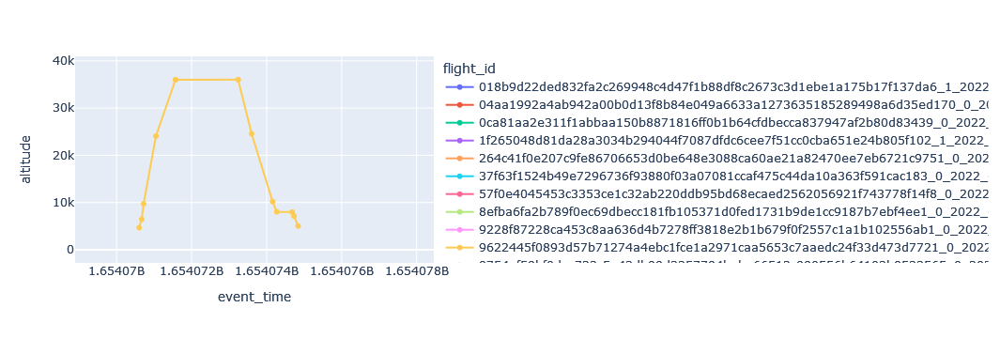

In [58]:
import plotly.express as px
import plotly.graph_objs as go
# Create the initial line plot
fig = px.line(tmp_sorted, x='event_time', y='altitude', color='flight_id', markers=True, hover_data = ['milestone_type'])
fig.show()

In [1]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import pandas_udf, PandasUDFType, col, when, lit, lag, lead, min, max, sum as Fsum, explode, array, monotonically_increasing_id
from pyspark.sql.window import Window
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType
from openap.phase import FlightPhase
from datetime import datetime
from pyspark.sql import functions as F

# Database prep

# Settings
project = "project_aiu"

# Getting today's date
today = datetime.today().strftime('%d %B %Y')

create_milestone_table_sql = f"""
    CREATE TABLE IF NOT EXISTS `{project}`.`osn_milestones` (
        
        id STRING COMMENT 'Primary Key: Unique milestone identifier for each record.',
        flight_id STRING COMMENT 'Foreign Key: Identifier linking the flight event to the flight trajectory table.',

        milestone_type STRING COMMENT 'Type of the flight event (milestone) being recorded.',
        event_time BIGINT COMMENT 'Timestamp for the flight event.',
        longitude DOUBLE COMMENT 'Longitude coordinate of the flight event.',
        latitude DOUBLE COMMENT 'Latitude coordinate of the flight event.',
        altitude DOUBLE COMMENT 'Altitude at which the flight event occurred.',
        
        source STRING COMMENT 'Source of the trajectory data.',
        version STRING COMMENT 'Version of the flight event (milestone) determination algorithm.',
        info STRING COMMENT 'Additional information or description of the flight event.'
    )
    COMMENT '`{project}`.`osn_milestones` table containing various OSN trajectory milestones. Last updated: {today}.'
    STORED AS parquet
    TBLPROPERTIES ('transactional'='false');
"""

spark.sql(f"DROP TABLE IF EXISTS `{project}`.`osn_milestones`;")
spark.sql(create_milestone_table_sql)

create_measurement_table_sql = f"""
    CREATE TABLE IF NOT EXISTS `{project}`.`osn_measurements` (
        
        id STRING COMMENT 'Primary Key: Unique measurement identifier for each record.',
        milestone_id STRING COMMENT 'Foreign Key: Identifier linking the measurement to the corresponding milestone in the milestone table.',
        
        type STRING COMMENT 'Type of measurement, e.g. flown distance or fuel consumption.',
        value DOUBLE COMMENT 'Value of the measurement.',
        version STRING COMMENT 'The version of the measurement calculation.'
    )
    COMMENT '`{project}`.`osn_measurements` table containing various measurements for OSN milestones. Last updated: {today}.'
    STORED AS parquet
    TBLPROPERTIES ('transactional'='false');
"""

spark.sql(f"DROP TABLE IF EXISTS `{project}`.`osn_measurements`;")
spark.sql(create_measurement_table_sql)



def calculate_horizontal_segment_events(sdf_input):
    df = sdf_input

    # Extracting OpenAP phases
    ## Defining variables

    df = df.withColumn("altitude_ft", col("baro_altitude") * 3.28084)
    df = df.withColumn("roc_ft_min", col("vert_rate") * 196.850394)
    df = df.withColumn("speed_kt", col("velocity") * 1.94384)

    ## Define schema for UDF
    schema = StructType([
        StructField("track_id", StringType()),
        StructField("icao24", StringType()),
        StructField("callsign", StringType()),
        StructField("lat", DoubleType()),
        StructField("lon", DoubleType()),
        StructField("event_time", IntegerType()),
        StructField("baro_altitude", DoubleType()),
        StructField("velocity", DoubleType()),
        StructField("vert_rate", DoubleType()),
        StructField("cumulative_distance_nm", DoubleType()),
        StructField("altitude_ft", DoubleType()),
        StructField("roc_ft_min", DoubleType()),
        StructField("speed_kt", DoubleType()),
        StructField("flight_phase", StringType())
    ])

    @pandas_udf(schema, PandasUDFType.GROUPED_MAP)
    def get_flight_phases(pdf):
        fp = FlightPhase()
        fp.set_trajectory(pdf['event_time'], pdf['altitude_ft'], pdf['speed_kt'], pdf['roc_ft_min'])
        pdf['flight_phase'] = fp.phaselabel()
        return pdf

    ## Apply UDF to get flight phases
    df_with_phases = df.groupby("track_id").apply(get_flight_phases)

    ## Window specification for detecting phase changes and for TOC/TOD
    windowSpecPhase = Window.partitionBy("track_id").orderBy("event_time")
    windowSpecTOC = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(Window.unboundedPreceding, 0)
    windowSpecTOD = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(0, Window.unboundedFollowing)

    ## Detect phase changes
    df_with_phases = df_with_phases.withColumn("prev_phase", lag("flight_phase", 1, "None").over(windowSpecPhase))
    df_with_phases = df_with_phases.withColumn("next_phase", lead("flight_phase", 1, "None").over(windowSpecPhase))

    ## Identify TOC and TOD for 'CR' phases
    df_with_phases = df_with_phases.withColumn("first_cr_time", min(when(col("flight_phase") == "CR", col("event_time"))).over(windowSpecTOC))
    df_with_phases = df_with_phases.withColumn("last_cr_time", max(when(col("flight_phase") == "CR", col("event_time"))).over(windowSpecTOD))

    ## Create event types

    ### Define a window spec for a cumulative sum, partitioned by track_id
    windowSpecCumulative = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(Window.unboundedPreceding, 0)

    ### Column to indicate the start of a level segment
    start_of_segment = (F.col("flight_phase").isin("CR", "LVL")) & (F.col("prev_phase") != F.col("flight_phase"))
    df_with_phases = df_with_phases.withColumn("start_of_segment", start_of_segment)

    ### Cumulative count of level segment starts
    df_with_phases = df_with_phases.withColumn("segment_count", F.sum(F.when(F.col("start_of_segment"), 1).otherwise(0)).over(windowSpecCumulative))

    ### Update milestone_types to include segment number
    df_with_phases = df_with_phases.withColumn(
        "milestone_types",
        F.when(F.col("event_time") == F.col("first_cr_time"), F.array(F.concat(F.lit("Start of Level Segment "), F.col("segment_count").cast("string")), F.lit("TOC")))
         .when(F.col("event_time") == F.col("last_cr_time"), F.array(F.concat(F.lit("End of Level Segment "), F.col("segment_count").cast("string")), F.lit("TOD")))
         .when(start_of_segment, F.array(F.concat(F.lit("Start of Level Segment "), F.col("segment_count").cast("string"))))
         .when((F.col("flight_phase").isin("CR", "LVL")) & (F.col("next_phase") != F.col("flight_phase")), F.array(F.concat(F.lit("End of Level Segment "), F.col("segment_count").cast("string"))))
         .when((F.col("prev_phase") == "GND") & (F.col("next_phase") == "CL"), F.array(F.lit("Take-off")))
         .when((F.col("prev_phase") == "DE") & (F.col("flight_phase") == "GND"), F.array(F.lit("Landing")))
         .otherwise(F.array())
    )

    ## Explode the event_types array to create rows for each event
    df_exploded = df_with_phases.select("*", explode(col("milestone_types")).alias("milestone_type"))

    ## Filter out rows with no relevant events
    df_exploded = df_exploded.filter("milestone_type IS NOT NULL")

    ## Reformat
    df_openap_events = df_exploded.select(
        col('track_id'),
        col('milestone_type'),
        col('event_time'),
        col('lon'),
        col('lat'),
        col('altitude_ft'),
        col('cumulative_distance_nm')
    )

    df_openap_events = df_openap_events.dropDuplicates(['track_id', 'milestone_type', 'event_time'])
    
    return df_openap_events

# Flight levels crossing extractions

# Your existing DataFrame loading code
def calculate_vertical_crossing_events(sdf_input)
    df = sdf_input

    ## Convert meters to flight level and create a new column
    df = df.withColumn("altitude_ft", col("baro_altitude") * 3.28084)
    df = df.withColumn("FL", (F.col("baro_altitude") * 3.28084 / 100).cast(DoubleType())).cache()

    # Smoothen altitude.. 
    window_spec_avg = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(-5, 5)
    #df = df.withColumn("FL", F.avg("FL").over(window_spec_avg))

    ## Window specification to order by event_time for each track_id
    window_spec = Window.partitionBy("track_id").orderBy("event_time")

    ## Add columns with lead FL values
    df = df.withColumn("next_FL", F.lead("FL").over(window_spec))

    ## Define the conditions for a crossing for each flight level of interest
    crossing_conditions = [
        (F.col("FL") < 50) & (F.col("next_FL") >= 50), # going up
        (F.col("FL") >= 50) & (F.col("next_FL") < 50), # going down
        (F.col("FL") < 70) & (F.col("next_FL") >= 70), # going up
        (F.col("FL") >= 70) & (F.col("next_FL") < 70), # going down
        (F.col("FL") < 100) & (F.col("next_FL") >= 100), # going up
        (F.col("FL") >= 100) & (F.col("next_FL") < 100), # going down
        (F.col("FL") < 245) & (F.col("next_FL") >= 245), # going up
        (F.col("FL") >= 245) & (F.col("next_FL") < 245), # going down

    ]

    ## Create a crossing column using multiple when conditions
    crossing_column = F.when(crossing_conditions[0], 50)
    for condition, flight_level in zip(crossing_conditions[1:], [50, 70, 70, 100, 100, 245, 245]):
        crossing_column = crossing_column.when(condition, flight_level)

    df = df.withColumn("crossing", crossing_column)

    ## Filter out only the rows where a crossing was detected
    crossing_points = df.filter(col("crossing").isNotNull())

    ## Filter out only the rows where the absolute difference between crossing and FL is less than 10 -> This filters out obvious errors
    crossing_points = crossing_points.filter(F.abs(F.col("crossing") - F.col("FL")) < 10)

    ## Identify first and last crossings by using window functions again
    ## Note that we need a separate window specification for descending order
    window_spec_crossing_asc = Window.partitionBy("track_id", "crossing").orderBy("event_time")
    window_spec_crossing_desc = Window.partitionBy("track_id", "crossing").orderBy(F.col("event_time").desc())

    crossing_points = crossing_points.withColumn(
        "row_number_asc",
        F.row_number().over(window_spec_crossing_asc)
    )
    crossing_points = crossing_points.withColumn(
        "row_number_desc",
        F.row_number().over(window_spec_crossing_desc)
    )

    ## Filter first and last crossings
    first_crossings = crossing_points.filter(F.col("row_number_asc") == 1)
    last_crossings = crossing_points.filter(F.col("row_number_desc") ==  1)

    ## Drop the temporary columns used for row numbering
    first_crossings = first_crossings.drop("row_number_asc", "row_number_desc")
    last_crossings = last_crossings.drop("row_number_asc", "row_number_desc")

    ## Add a label to indicate first or last crossing
    first_crossings = first_crossings.withColumn("milestone_type", F.concat(F.lit("First Crossing FL"), F.col('crossing').cast("string")))
    last_crossings = last_crossings.withColumn("milestone_type", F.concat(F.lit("Last Crossing FL"), F.col('crossing').cast("string")))

    ## Combine the first and last crossing data
    all_crossings = first_crossings.union(last_crossings)

    ## Clean up
    df_lvl_events = all_crossings.select(
        col('track_id'),
        col('milestone_type'),
        col('event_time'),
        col('lon'),
        col('lat'),
        col('altitude_ft'),
        col('cumulative_distance_nm')
    )

    df_lvl_events = df_lvl_events.dropDuplicates(['track_id', 'milestone_type', 'event_time', 'lon', 'lat', 'altitude_ft', 'cumulative_distance_nm'])
    
    return df_lvl_events

# Final ETL - Combining the datasets and writing away.. 

def etl_all_flight_events(sdf_input, batch_id):
    df_openap_events = calculate_horizontal_segment_events(sdf_input)
    df_lvl_events = calculate_vertical_crossing_events(sdf_input)

    df_events = df_openap_events.union(df_lvl_events)
    df_events = df_events.withColumn('source', F.lit('OSN'))
    df_events = df_events.withColumn('version', F.lit('milestones_v0.0.2'))
    df_events = df_events.withColumn('info', F.lit(''))

    df_events = df_events.withColumn("id_tmp", F.concat(F.lit(batch_id),monotonically_increasing_id().cast('string'))).select(
        col('id_tmp'),
        col('track_id'),
        col('milestone_type'),
        col('event_time'),
        col('lon'),
        col('lat'),
        col('altitude_ft'),
        col('source'),
        col('version'),
        col('info'),
        col('cumulative_distance_nm')
    )

    # Milestones table

    df_milestones = df_events.select(
        col('id_tmp').alias('id'),
        col('track_id').alias('track_id'),
        col('milestone_type').alias('milestone_type'),
        col('event_time').alias('event_time'),
        col('lon').alias('longitude'),
        col('lat').alias('latitude'),
        col('altitude_ft').alias('altitude'),
        col('source').alias('source'),
        col('version').alias('version'),
        col('info').alias('info'),
    )

    df_milestones.write.mode("append").insertInto(f"`{project}`.`osn_milestones`")

    # Measurements table 

    df_measurements = df_events.withColumn('type',F.lit('Distance flown (NM)'))
    df_measurements = df_measurements.withColumn('version',F.lit('distance_v0.0.2'))

    df_measurements = df_measurements.withColumn("id", F.concat(F.lit(batch_id),monotonically_increasing_id().cast('string'))).select(
        col('id'),
        col('id_tmp').alias('milestone_id'),
        col('type'),
        col('cumulative_distance_nm').alias('value'),
        col('version')
    )

    df_measurements.write.mode("append").insertInto(f"`{project}`.`osn_measurements`")

# Run code.. 

def get_next_month(dt):
    """Get the first day of the next month."""
    year, month = dt.year + (dt.month // 12), dt.month % 12 + 1
    return datetime(year, month, 1)

# Determine the range of event_time
time_range = spark.sql(f"SELECT MIN(event_time), MAX(event_time) FROM `{project}`.`osn_tracks`").collect()
min_time, max_time = time_range[0]

# Convert min_time and max_time from Unix timestamp to datetime
start_date = datetime.utcfromtimestamp(min_time)
end_date = datetime.utcfromtimestamp(max_time)

print('-'*30)
print(f'Starting milestone extraction process for timeframe {start_date} until {end_date}...')

# Loop through time range in monthly batches
current_date = start_date
while current_date <= end_date:
    next_month_date = get_next_month(current_date)
    next_month_timestamp = int(next_month_date.timestamp())
    
    print(f'Currently processing {current_date} - {next_month_date}')
    
    # Perform the milestone operation for the current month
    sdf_input = spark.sql(f"""
        SELECT track_id, icao24, callsign, lat, lon, event_time, baro_altitude, velocity, vert_rate, cumulative_distance_nm
        FROM `project_aiu`.`osn_tracks_clustered`
        WHERE event_time >= {int(current_date.timestamp())}
        AND event_time < {next_month_timestamp}""").persist()

    etl_flight_events(sdf_input, batch_id = current_date.strftime("%Y%m") + '_')
    sdf_input.unpersist()

    # Move to the next month
    current_date = next_month_date

# Cleanup
#spark.sql(f"""DROP TABLE IF EXISTS `{project}`.`osn_tracks`;""")

# Stop the SparkSession
spark.stop()

Setting spark.hadoop.yarn.resourcemanager.principal to quinten.goens


## Milestones based on OpenAP and measurements code

Hive Session ID = bf210d37-f8eb-4598-bb99-752f1f7466bf
/opt/spark/python/lib/pyspark.zip/pyspark/sql/pandas/group_ops.py:81: UserWarning: It is preferred to use 'applyInPandas' over this API. This API will be deprecated in the future releases. See SPARK-28264 for more details.


In [3]:
sql = 'SELECT * FROM `project_aiu`.`osn_milestones`;'

df = spark.sql(sql).toPandas()

In [4]:
tracks = spark.sql("""
    SELECT track_id, icao24, callsign, lat, lon, event_time, baro_altitude, velocity, vert_rate, cumulative_distance_nm
    FROM `project_aiu`.`osn_tracks_clustered_sample`;
""")

tracks = tracks.toPandas()

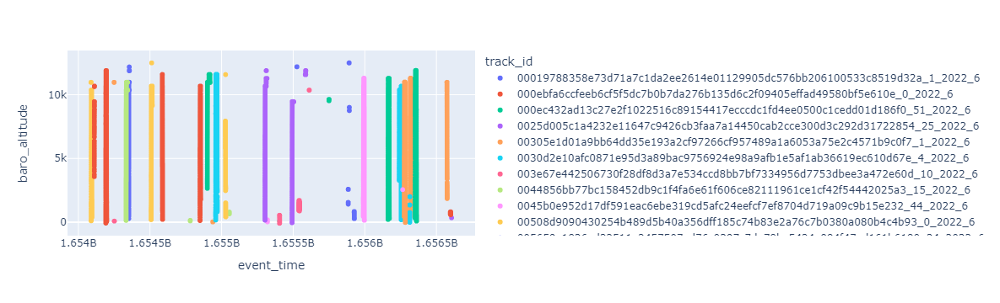

In [7]:
import plotly.express as px

px.scatter(tracks,x='event_time', y = 'baro_altitude', color ='track_id')

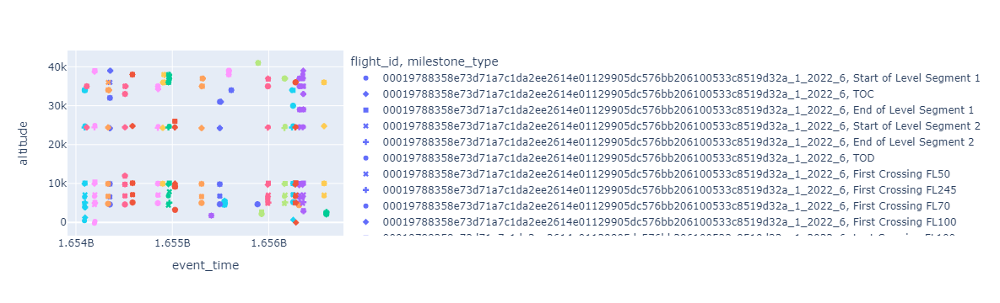

In [8]:
import plotly.express as px

px.scatter(df,x='event_time', y = 'altitude', color ='flight_id', symbol='milestone_type')

In [57]:
df = df[df.milestone_type.str.contains('Crossing')]

In [9]:
df[df.flight_id.str.contains('00b10383cd205722809d871397a1181e051e976a69b519')]

,id,flight_id,milestone_type,event_time,longitude,latitude,altitude,source,version,info
80,80,00b10383cd205722809d871397a1181e051e976a69b519...,Start of Level Segment 1,1656350860,11.110516,60.194458,NaN,OSN,milestones_v0.0.1,
81,81,00b10383cd205722809d871397a1181e051e976a69b519...,End of Level Segment 1,1656351330,11.113823,60.193999,NaN,OSN,milestones_v0.0.1,
82,82,00b10383cd205722809d871397a1181e051e976a69b519...,Start of Level Segment 2,1656351340,11.113823,60.193999,NaN,OSN,milestones_v0.0.1,
83,83,00b10383cd205722809d871397a1181e051e976a69b519...,TOC,1656351340,11.113823,60.193999,NaN,OSN,milestones_v0.0.1,
84,84,00b10383cd205722809d871397a1181e051e976a69b519...,End of Level Segment 2,1656351390,11.116246,60.197193,NaN,OSN,milestones_v0.0.1,
85,85,00b10383cd205722809d871397a1181e051e976a69b519...,Start of Level Segment 3,1656351400,11.116246,60.197193,NaN,OSN,milestones_v0.0.1,
86,86,00b10383cd205722809d871397a1181e051e976a69b519...,End of Level Segment 3,1656351510,11.119464,60.195896,NaN,OSN,milestones_v0.0.1,
87,87,00b10383cd205722809d871397a1181e051e976a69b519...,Start of Level Segment 4,1656352720,12.605660,58.813980,37000.001184,OSN,milestones_v0.0.1,
88,88,00b10383cd205722809d871397a1181e051e976a69b519...,End of Level Segment 4,1656354090,12.995661,56.332626,37050.001186,OSN,milestones_v0.0.1,
89,89,00b10383cd205722809d871397a1181e051e976a69b519...,Start of Level Segment 5,1656354220,13.100364,56.098297,38050.001218,OSN,milestones_v0.0.1,


In [ ]:
create_milestone_table_sql = f"""
    CREATE TABLE IF NOT EXISTS `{project}`.`osn_milestones_submission` (
        
        id STRING COMMENT 'Primary Key: Unique identifier for each record.',
        flight_id STRING COMMENT 'Foreign Key: Identifier linking the flight event to the flight trajectory table.',
        icao24 STRING COMMENT 'The ICAO24 of the flight event.',
        callsign STRING COMMENT 'The callsign of the flight event.',
        DOF DATETIME COMMENT 'The date of flight (i.e., the date at time of first observation).',
        
        ADEP STRING COMMENT 'The best guess for the aerodrome of departure (ADEP) of the flight based on the available flight trajectory.',
        ADES STRING COMMENT 'The best guess for the aerodrome of destination (ADES) of the flight based on the available flight trajectory.',

        milestone_type STRING COMMENT 'Type of the flight event (milestone) being recorded.',
        event_time TIMESTAMP COMMENT 'Timestamp for the flight event.',
        longitude DOUBLE COMMENT 'Longitude coordinate of the flight event.',
        latitude DOUBLE COMMENT 'Latitude coordinate of the flight event.',
        altitude DOUBLE COMMENT 'Altitude at which the flight event occurred.',
        info STRING COMMENT 'Additional information or description of the flight event.'
        
        cumulative_distance_nm DOUBLE COMMENT 'The cumulative ground distance flown at the time of the flight event from the start of the trajectory in nautic miles.',
        cumulative_distance_nm_version STRING COMMENT 'Version of the algorithm used for the calculation of cumulative_distance_nm.',
        
        source STRING COMMENT 'Source of the trajectory data.',
        version STRING COMMENT 'Version of the flight event (milestone) determination algorithm.',
    )
    COMMENT '`{project}`.`osn_milestones` table containing various OSN trajectory milestones. Last updated: {today}.'
    STORED AS parquet
    TBLPROPERTIES ('transactional'='false');
"""


In [6]:
h3_resolution = 11
project = "project_aiu"

# Getting today's date
today = datetime.today().strftime('%d %B %Y')
create_osn_tracks_clustered_sql = f"""
    CREATE TABLE IF NOT EXISTS `{project}`.`osn_tracks_clustered_sample` (
        event_time BIGINT COMMENT 'This column contains the unix (aka POSIX or epoch) timestamp for which the state vector was valid.',
        icao24 STRING COMMENT 'This column contains the 24-bit ICAO transponder ID which can be used to track specific airframes over different flights.',
        lat DOUBLE COMMENT 'This column contains the last known latitude of the aircraft.',
        lon DOUBLE COMMENT 'This column contains the last known longitude of the aircraft.',
        velocity DOUBLE COMMENT 'This column contains the speed over ground of the aircraft in meters per second.',
        heading DOUBLE COMMENT 'This column represents the direction of movement (track angle in degrees) as the clockwise angle from the geographic north.',
        vert_rate DOUBLE COMMENT 'This column contains the vertical speed of the aircraft in meters per second.',
        callsign STRING COMMENT 'This column contains the callsign that was broadcast by the aircraft.',
        on_ground BOOLEAN COMMENT 'This flag indicates whether the aircraft is broadcasting surface positions (true) or airborne positions (false).',
        alert BOOLEAN COMMENT 'This flag is a special indicator used in ATC.',
        spi BOOLEAN COMMENT 'This flag is a special indicator used in ATC.',
        squawk STRING COMMENT 'This 4-digit octal number is another transponder code which is used by ATC and pilots for identification purposes and indication of emergencies.',
        baro_altitude DOUBLE COMMENT 'This column indicates the aircrafts altitude. As the names suggest, baroaltitude is the altitude measured by the barometer (in meter).',
        geo_altitude DOUBLE COMMENT 'This column indicates the aircrafts altitude. As the names suggest, geoaltitude is determined using the GNSS (GPS) sensor (in meter).',
        last_pos_update DOUBLE COMMENT 'This unix timestamp indicates the age of the position.',
        last_contact DOUBLE COMMENT 'This unix timestamp indicates the time at which OpenSky received the last signal of the aircraft.',
        serials ARRAY<INT> COMMENT 'The serials column is a list of serials of the ADS-B receivers which received the message.',
        track_id STRING COMMENT 'Unique identifier for the associated flight tracks in `{project}`.`osn_flight_table`.',
        h3_id_res_{h3_resolution} STRING COMMENT 'H3 cell identifier for lat and lon with H3 resolution {h3_resolution}.',
        segment_distance_nm DOUBLE COMMENT 'The distance from the previous statevector in nautic miles.',
        cumulative_distance_nm DOUBLE COMMENT 'The cumulative distance from the start in nautic miles.'
    )
    COMMENT 'Clustered `{project}`.`osn_statevectors_clustered` with added track_ids (generated based on callsign, icao24 grouping with 30 min signal gap intolerance). Last updated: {today}.'
    CLUSTERED BY (track_id, event_time, icao24, callsign, geo_altitude, h3_id_res_{h3_resolution}) INTO 4096 BUCKETS
    STORED AS parquet
    TBLPROPERTIES ('transactional'='false');"""

spark.sql(f"DROP TABLE IF EXISTS `{project}`.`osn_tracks_clustered_sample`;")
spark.sql(create_osn_tracks_clustered_sql)

Hive Session ID = 066e9061-11ea-42f4-a8ba-c010296e6dc8


DataFrame[]

In [7]:
spark.sql(f"""
  INSERT INTO TABLE `{project}`.`osn_tracks_clustered_sample` 
  SELECT * FROM `{project}`.`osn_tracks` LIMIT 50000;
""")

DataFrame[]

## Flight level crossings milestones

In [3]:
from pyspark.sql import SparkSession, functions as F
from pyspark.sql.window import Window
from pyspark.sql.types import DoubleType
from pyspark.sql.functions import lead, lag, col, when, lit, row_number

# Initialize Spark session
spark = SparkSession.builder.appName("flight_level_crossing").getOrCreate()

# Read data from the database (this should be your own database and query)
track_df = spark.sql("""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered_backup`
    LIMIT 50000
""")


# Stop the Spark session if it's the end of your application
spark.stop()

23/11/13 11:53:45 167 ERROR Utils: Uncaught exception in thread kubernetes-executor-pod-polling-sync
io.fabric8.kubernetes.client.KubernetesClientException: Operation: [list]  for kind: [Pod]  with name: [null]  in namespace: [mlx-user-72]  failed.
	at io.fabric8.kubernetes.client.KubernetesClientException.launderThrowable(KubernetesClientException.java:64)
	at io.fabric8.kubernetes.client.KubernetesClientException.launderThrowable(KubernetesClientException.java:72)
	at io.fabric8.kubernetes.client.dsl.base.BaseOperation.listRequestHelper(BaseOperation.java:145)
	at io.fabric8.kubernetes.client.dsl.base.BaseOperation.list(BaseOperation.java:552)
	at io.fabric8.kubernetes.client.dsl.base.BaseOperation.list(BaseOperation.java:88)
	at org.apache.spark.scheduler.cluster.k8s.ExecutorPodsPollingSnapshotSource$PollRunnable.$anonfun$run$1(ExecutorPodsPollingSnapshotSource.scala:73)
	at org.apache.spark.util.Utils$.tryLogNonFatalError(Utils.scala:1471)
	at org.apache.spark.scheduler.cluster.k8s

In [4]:
df = pd.read_parquet('all_crossings.parquet')

In [9]:
df

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,...,last_pos_update,last_contact,serials,track_id,h3_id_res_11,FL,next_FL,prev_FL,crossing,crossing_type
0,1661148320,501d21,44.224182,16.570522,209.731696,15.945396,6.17728,CTN284E,False,False,...,1.661148e+09,1.661148e+09,[83759315],0026ff53aefec413c59aad4641cf6813b0f362aaa0588b...,8b1ea8ace662fff,239.500008,246.500008,239.500008,245,first
1,1659332210,3007ee,48.357487,11.681286,103.022469,278.615648,14.95552,DLH9HX,False,False,...,1.659332e+09,1.659332e+09,"[1408235457, -1408234507, 91515, -1408234028, ...",0028d982ee5c4238caad42d28d340594c05aa9b977e500...,8b1f8d0a9cabfff,48.000002,51.750002,48.000002,50,first
2,1659332280,3007ee,48.426544,11.639803,137.819154,349.025617,5.20192,DLH9HX,False,False,...,1.659332e+09,1.659332e+09,"[1408233257, 701807807, -1408234481, 143590710...",0028d982ee5c4238caad42d28d340594c05aa9b977e500...,8b1f8d015c82fff,68.500002,70.250002,68.500002,70,first
3,1659332360,3007ee,48.525421,11.610718,142.055493,348.934224,18.53184,DLH9HX,False,False,...,1.659332e+09,1.659332e+09,"[1408233257, -1408231796, 701807807, -14082333...",0028d982ee5c4238caad42d28d340594c05aa9b977e500...,8b1f8d11d79dfff,96.500003,102.250003,96.500003,100,first
4,1659332790,3007ee,49.118989,11.277899,200.336146,338.772349,8.45312,DLH9HX,False,False,...,1.659333e+09,1.659333e+09,"[1408233257, -1408232514, -1408231781, -140823...",0028d982ee5c4238caad42d28d340594c05aa9b977e500...,8b1fab2a541cfff,243.000008,245.750008,243.000008,245,first
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,1668447380,0a0093,48.534292,2.265497,200.639096,180.440728,14.95552,DAH1115,False,False,...,1.668447e+09,1.668447e+09,"[1549047001, -1408236405, 90365, -1408237044, ...",01d9cb8dc0362f59ebde466f75153b0defb4f5aa8cab38...,8b1fb0d0320afff,247.000008,247.000008,242.250008,245,last
146,1668535010,0a0093,48.990280,2.454036,108.821627,265.933681,7.80288,DAH1115,False,False,...,1.668535e+09,1.668535e+09,"[-1408234504, 1549047001, -1408231437, -140823...",01d9cb8dc0362f59ebde466f75153b0defb4f5aa8cab38...,8b1fb42a22e0fff,52.000002,52.000002,49.500002,50,last
147,1668535050,0a0093,48.987076,2.388047,125.475834,265.060784,16.90624,DAH1115,False,False,...,1.668535e+09,1.668535e+09,"[1549047001, -1408231437, -1408237044, -140823...",01d9cb8dc0362f59ebde466f75153b0defb4f5aa8cab38...,8b1fb42b42b0fff,70.250002,70.250002,64.750002,70,last
148,1668535110,0a0093,48.970999,2.288842,128.467905,218.659808,15.28064,DAH1115,False,False,...,1.668535e+09,1.668535e+09,"[-1408234504, 1549047001, -1408231437, -140823...",01d9cb8dc0362f59ebde466f75153b0defb4f5aa8cab38...,8b1fb4745ad9fff,102.750003,102.750003,97.750003,100,last


## ToC and ToD

In [21]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import pandas_udf, PandasUDFType, col, when, min, max
from pyspark.sql.window import Window
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType
from openap.phase import FlightPhase

# Read your data into a PySpark DataFrame

df = spark.sql("""
    SELECT track_id, icao24, callsign, lat, lon, event_time, baro_altitude, velocity, vert_rate
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 5000000
""")

# Convert baro_altitude from meters to feet (1 meter = 3.28084 feet)
df = df.withColumn("altitude_ft", col("baro_altitude") * 3.28084)

# Convert vert_rate from meters per second to feet per minute (1 m/s = 196.850394 ft/min)
df = df.withColumn("roc_ft_min", col("vert_rate") * 196.850394)

# Assuming 'velocity' is in meters per second and needs to be converted to knots
# (1 meter per second = 1.94384 knots)
df = df.withColumn("speed_kt", col("velocity") * 1.94384)

schema = StructType([
    StructField("track_id", StringType()),
    StructField("icao24", StringType()),
    StructField("callsign", StringType()),
    StructField("lat", DoubleType()),
    StructField("lon", DoubleType()),
    StructField("event_time", IntegerType()),
    StructField("baro_altitude", DoubleType()),
    StructField("velocity", DoubleType()),
    StructField("vert_rate", DoubleType()),
    StructField("altitude_ft", DoubleType()),
    StructField("roc_ft_min", DoubleType()),
    StructField("speed_kt", DoubleType()),
    StructField("flight_phase", StringType())
])

# Define a UDF that applies the flight phase logic to a Pandas DataFrame
@pandas_udf(schema, PandasUDFType.GROUPED_MAP)
def get_flight_phases(pdf):
    # Access the broadcasted FlightPhase object
    fp = FlightPhase()

    # Set the trajectory data
    fp.set_trajectory(pdf['event_time'], pdf['altitude_ft'], pdf['speed_kt'], pdf['roc_ft_min'])

    # Get the phase labels
    pdf['flight_phase'] = fp.phaselabel()

    return pdf

# Group the data by some identifier of a trajectory, e.g., flight_id
# and apply the UDF to each group
df_with_phases = df.groupby("track_id").apply(get_flight_phases)

# Filter the DataFrame for 'CR' flight phase
df_cr = df_with_phases.filter(df_with_phases.flight_phase == 'CR')

# Define the window spec
windowSpec = Window.partitionBy("track_id")

# Find the min and max event_time for each track_id
df_cr = df_cr.withColumn("min_event_time", min("event_time").over(windowSpec))
df_cr = df_cr.withColumn("max_event_time", max("event_time").over(windowSpec))

# Define the flight event based on the min and max event_time
df_cr = df_cr.withColumn(
    "flight_event",
    F.when(col("event_time") == col("min_event_time"), "top of climb")
     .when(col("event_time") == col("max_event_time"), "top of descent")
     .otherwise(None)
)

# Now filter out the rows that are not 'top of climb' or 'top of descent'
df_cr = df_cr.filter("flight_event IS NOT NULL")

# Show the result
#df_cr = df_cr.toPandas()

/opt/spark/python/lib/pyspark.zip/pyspark/sql/pandas/group_ops.py:81: UserWarning:

It is preferred to use 'applyInPandas' over this API. This API will be deprecated in the future releases. See SPARK-28264 for more details.



## Level Segments

In [ ]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import pandas_udf, PandasUDFType, col, when, lag, sum as Fsum, lead
from pyspark.sql.window import Window
from pyspark.sql.types import StructType, StructField, DoubleType, IntegerType, StringType
from openap.phase import FlightPhase

# Define the window spec for detecting phase changes
windowSpecPhase = Window.partitionBy("track_id").orderBy("event_time")

# Detect phase changes by comparing each phase with the previous one
df_with_phases = df_with_phases.withColumn(
    "phase_change",
    when(
        col("flight_phase") != lag("flight_phase", 1, 0).over(windowSpecPhase),
        1
    ).otherwise(0)
)

# Use a cumulative sum to label each phase change
df_with_phases = df_with_phases.withColumn(
    "phase_label",
    Fsum("phase_change").over(windowSpecPhase)
)

# Pre-calculate the flag for the end of a segment
df_with_phases = df_with_phases.withColumn(
    "next_phase_change",
    lead("phase_change", 1, 0).over(windowSpecPhase)
)

# Now, identify the beginning and end of 'CR' or 'LVL' segments
df_with_phases = df_with_phases.withColumn(
    "segment_event",
    when(
        (col("flight_phase").isin("CR", "LVL")) & (col("phase_change") == 1),
        "beginning level segment"
    ).when(
        (col("flight_phase").isin("CR", "LVL")) & (col("next_phase_change") == 1),
        "end level segment"
    ).otherwise(None)
)

# Filter out the rows that are not 'beginning level segment' or 'end level segment'
df_segments = df_with_phases.filter("segment_event IS NOT NULL")

# Show the result
df_tmp = df_with_phases.toPandas()


In [1]:
df_tmp.to_parquet('df_tmp.parquet')

NameError: name 'df_tmp' is not defined

In [20]:
df_tmp['segment_event'].value_counts()

none                       49822
beginning level segment       89
end level segment             89
Name: segment_event, dtype: int64

In [17]:
df_tmp['segment_event'].fillna('none',inplace=True)

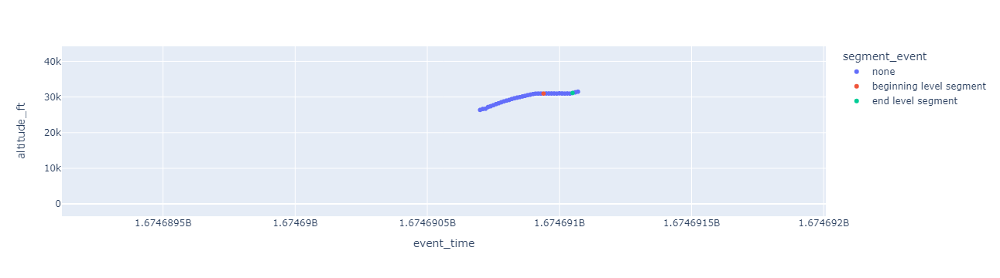

In [18]:
import plotly.express as px
px.scatter(df_tmp, x='event_time', y='altitude_ft', color='segment_event')

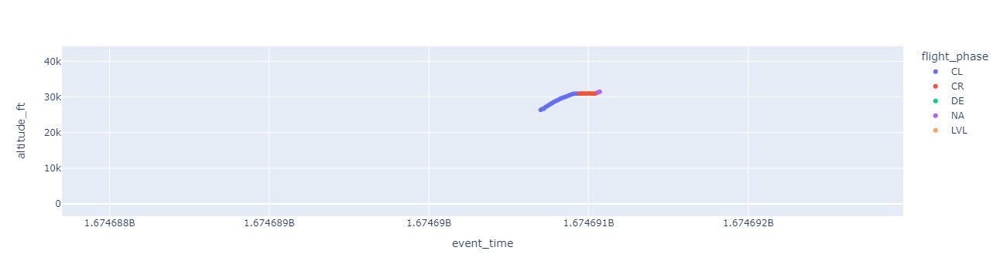

In [19]:
import plotly.express as px
px.scatter(df_tmp, x='event_time', y='altitude_ft', color='flight_phase')

In [3]:
pdf_with_phases

,track_id,event_time,baro_altitude,velocity,vert_rate,altitude_ft,roc_ft_min,speed_kt,flight_phase
0,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
1,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
2,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719740,579.12,89.958591,12.35456,1900.000061,2432.000004,174.865108,CL
3,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719750,655.32,97.322417,7.80288,2150.000069,1536.000002,189.179208,CL
4,000b450cdc1371e29e5ab3f6c1d09053526dc6a98c3d89...,1667719750,655.32,97.322417,7.80288,2150.000069,1536.000002,189.179208,CL
...,...,...,...,...,...,...,...,...,...
49995,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652280,243.84,70.705645,-4.22656,800.000026,-832.000001,137.440460,DE
49996,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652290,205.74,71.218450,-3.25120,675.000022,-640.000001,138.437272,NA
49997,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652290,205.74,71.218450,-3.25120,675.000022,-640.000001,138.437272,NA
49998,032cb81e3d09d8e107f53aa709954b07563fb763b929fd...,1667652300,167.64,71.218450,-3.90144,550.000018,-768.000001,138.437272,NA


In [5]:
pdf_with_phases.track_id.nunique()

54

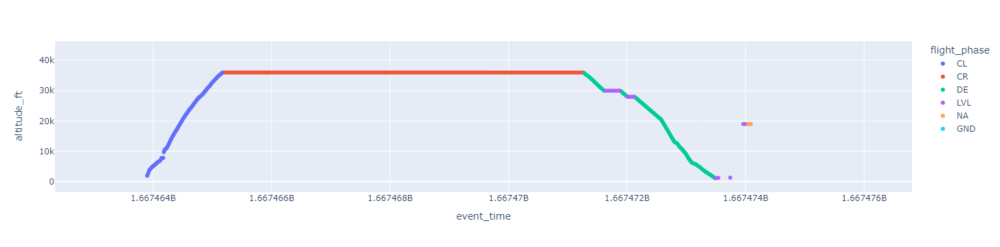

In [4]:
import plotly.express as px
px.scatter(pdf_with_phases, x='event_time',y='altitude_ft', color = 'flight_phase')

In [16]:
df = pd.read_parquet('all_crossings_pdf.parquet')

In [20]:
import plotly.express as px

In [36]:
df.groupby(['track_id']).count().event_time.max()

4

/tmp/ipykernel_193/4052596413.py:1: FutureWarning:

The 'freq' argument in Timestamp is deprecated and will be removed in a future version.



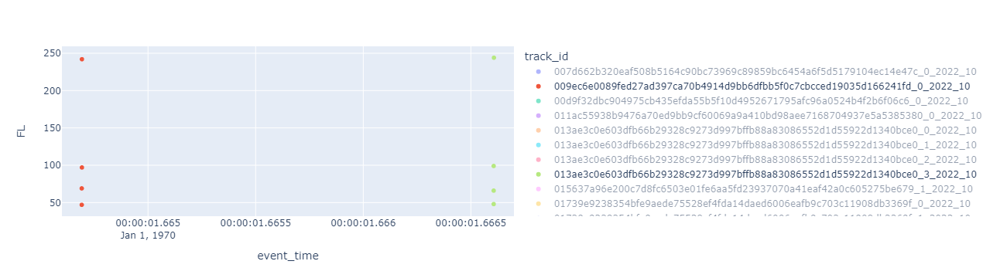

In [30]:
df['event_time'] = df['event_time'].apply(lambda l: pd.Timestamp(l, 's'))
px.scatter(df, x='event_time', y = 'FL', color = 'track_id')

In [3]:
df['FL_diff'] = df['FL'] - df['crossing']

In [4]:
track_ids = df[df['FL_diff'].apply(abs) > 10].track_id.to_list()[:10]

# Convert the list of track_ids to a tuple, which is safe to include in a SQL query.
# If track_ids is empty, the IN clause will throw an error, hence we check for that.
track_ids_tuple = tuple(track_ids) if track_ids else (None,)

# Now, you can format the SQL query string using the track_ids_tuple.
# You need to ensure the tuple is converted to a string properly if there's only one id (adding a comma).
track_ids_str = str(track_ids_tuple)
if len(track_ids) == 1:
    track_ids_str = f"({track_ids_tuple[0]},)"  # For a single element, make it a tuple

# Construct the query using the formatted string.
query = f"""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered`
    WHERE track_id IN {track_ids_str}
"""

# Execute the query with Spark SQL.
track_df = spark.sql(query).toPandas()

Hive Session ID = eb0d2648-6ac1-4d55-92a5-597936941b58


In [5]:
track_df.to_parquet('track_df.parquet')

In [6]:
track_df

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,serials,track_id,h3_id_res_11
0,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
1,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
2,1662641640,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,"[1801277291, 696601879]",7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
3,1662641650,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,[696601879],7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
4,1662641650,4bab52,50.045204,8.57121,NaN,NaN,NaN,THY7FH,True,False,False,None,NaN,NaN,1.662642e+09,1.662642e+09,[696601879],7c81d4ee47c35f22540da860fb48f52f576541cf3c55e4...,8b1faea82170fff
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22794,1663333890,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22795,1663333890,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22796,1663333900,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff
22797,1663333900,4692c7,52.356371,13.50461,49.198709,248.532349,-0.32512,AEE512,True,False,False,1755,NaN,NaN,1.663334e+09,1.663334e+09,[],80047ca8c4a8a484dba5f7c803651b77c106fcc00e1c42...,8b1f18a26206fff


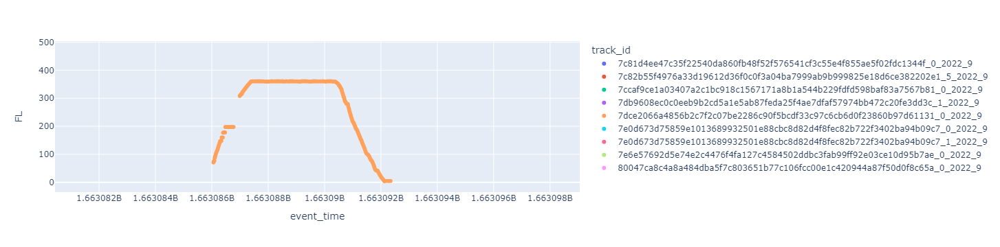

In [10]:
import plotly.express as px
track_df['FL']=track_df['baro_altitude']* 3.28084 / 100
px.scatter(track_df, x='event_time', y = 'FL', color = 'track_id')

In [10]:
from pyspark.sql import SparkSession
from pyspark.sql import functions as F
from pyspark.sql.window import Window
from pyspark.sql import DataFrame

def calculate_cumulative_distance(df: DataFrame) -> DataFrame:
    """
    Calculate the great circle distance between consecutive points in nautical miles
    and the cumulative distance for each track, using native PySpark functions.

    Parameters:
    df (DataFrame): Input Spark DataFrame. Assumes columns "lat", "lon", "track_id", "event_time".

    Returns:
    DataFrame: DataFrame with additional columns "distance_nm" and "cumulative_distance_nm".
    """

    # Define a window spec for lag operation and cumulative sum
    windowSpecLag = Window.partitionBy("track_id").orderBy("event_time")
    windowSpecCumSum = Window.partitionBy("track_id").orderBy("event_time").rowsBetween(Window.unboundedPreceding, 0)

    # Convert degrees to radians using PySpark native function
    df = df.withColumn("lat_rad", F.radians(F.col("lat")))
    df = df.withColumn("lon_rad", F.radians(F.col("lon")))

    # Getting previous row's latitude and longitude
    df = df.withColumn("prev_lat_rad", F.lag("lat_rad").over(windowSpecLag))
    df = df.withColumn("prev_lon_rad", F.lag("lon_rad").over(windowSpecLag))

    # Compute the great circle distance using haversine formula in PySpark native functions
    df = df.withColumn("a", 
                       F.sin((F.col("lat_rad") - F.col("prev_lat_rad")) / 2)**2 + 
                       F.cos(F.col("prev_lat_rad")) * F.cos(F.col("lat_rad")) * 
                       F.sin((F.col("lon_rad") - F.col("prev_lon_rad")) / 2)**2)

    df = df.withColumn("c", 2 * F.atan2(F.sqrt(F.col("a")), F.sqrt(1 - F.col("a"))))

    # Radius of Earth in kilometers is 6371
    df = df.withColumn("distance_km", 6371 * F.col("c"))

    # Convert distance to nautical miles; 1 nautical mile = 1 / 1.852 km
    df = df.withColumn("segment_distance_nm", F.col("distance_km") / 1.852)

    # Calculate the cumulative distance
    df = df.withColumn("cumulative_distance_nm", F.sum("distance_nm").over(windowSpecCumSum))

    # Drop temporary columns used for calculations
    df = df.drop("lat_rad", "lon_rad", "prev_lat_rad", "prev_lon_rad", "a", "c", "distance_km")

    return df

# Read the data (assuming data is in place)
df = spark.sql("""
    SELECT *
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 100000;
""")

# Calculate distances
df_with_distances = calculate_cumulative_distance(df)

# Calculate first milestones

## Flight levels FL50, FL70, FL100, FL245

pdf_with_distances = df_with_distances.toPandas()

In [14]:
pdf_with_distances

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,...,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,serials,track_id,h3_id_res_11,distance_nm,cumulative_distance_nm
0,1690263040,4b8e19,37.982064,29.494291,208.643672,11.088286,5.20192,PGT9,False,False,...,None,9738.36,10317.48,1.690263e+09,1.690263e+09,[1408236197],00bf8a58f72e6bb1a5880223f5c2bc3ff1c2df27adce3c...,8b3f6102905efff,NaN,NaN
1,1690263040,4b8e19,37.982064,29.494291,208.643672,11.088286,5.20192,PGT9,False,False,...,None,9738.36,10317.48,1.690263e+09,1.690263e+09,[1408236197],00bf8a58f72e6bb1a5880223f5c2bc3ff1c2df27adce3c...,8b3f6102905efff,0.000000,0.000000
2,1690263050,4b8e19,37.982064,29.494291,209.247844,11.199430,0.32512,PGT9,False,False,...,None,9738.36,10325.10,1.690263e+09,1.690263e+09,[1408236197],00bf8a58f72e6bb1a5880223f5c2bc3ff1c2df27adce3c...,8b3f6102905efff,0.000000,0.000000
3,1690263050,4b8e19,37.982064,29.494291,209.247844,11.199430,0.32512,PGT9,False,False,...,None,9738.36,10325.10,1.690263e+09,1.690263e+09,[1408236197],00bf8a58f72e6bb1a5880223f5c2bc3ff1c2df27adce3c...,8b3f6102905efff,0.000000,0.000000
4,1690263060,4b8e19,38.011093,29.501564,210.257234,11.144974,0.00000,PGT9,False,False,...,None,9761.22,10347.96,1.690263e+09,1.690263e+09,[1408236197],00bf8a58f72e6bb1a5880223f5c2bc3ff1c2df27adce3c...,8b3f6115a982fff,1.776573,1.776573
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1689432560,462dd1,47.146989,16.312866,121.775534,281.452341,0.00000,FSF103H,False,False,...,1000,7315.20,7795.26,1.689433e+09,1.689433e+09,"[-1408232577, 1643341395, -1408233324, -140823...",04b70d0571cf801f8c1b0f3a4e3b3dcf2541446c50e31b...,8b1e11d4d6e6fff,0.000000,130.248577
99996,1689432570,462dd1,47.149131,16.296809,121.478519,280.738897,0.00000,FSF103H,False,False,...,1000,7315.20,7795.26,1.689433e+09,1.689433e+09,"[-1408232577, 1643341395, -1408233324, -140823...",04b70d0571cf801f8c1b0f3a4e3b3dcf2541446c50e31b...,8b1e11d4d4a0fff,0.668154,130.916731
99997,1689432570,462dd1,47.149131,16.296809,121.478519,280.738897,0.00000,FSF103H,False,False,...,1000,7315.20,7795.26,1.689433e+09,1.689433e+09,"[-1408232577, 1643341395, -1408233324, -140823...",04b70d0571cf801f8c1b0f3a4e3b3dcf2541446c50e31b...,8b1e11d4d4a0fff,0.000000,130.916731
99998,1689432570,462dd1,47.149131,16.296809,121.478519,280.738897,0.00000,FSF103H,False,False,...,1000,7315.20,7795.26,1.689433e+09,1.689433e+09,"[-1408232577, 1643341395, -1408233324, -140823...",04b70d0571cf801f8c1b0f3a4e3b3dcf2541446c50e31b...,8b1e11d4d4a0fff,0.000000,130.916731


In [10]:


# Convert meters to flight level and create a new column
track_df = track_df.withColumn("FL", (col("baro_altitude") * 3.28084 / 100).cast("integer"))

# Define the flight levels of interest
FL = [40, 70, 100, 245]

# Window specification to order by event_time for each track_id
window_spec = Window.partitionBy("track_id").orderBy("event_time")

# Add columns with lead and lag FL values
track_df = track_df.withColumn("next_FL", lead("FL").over(window_spec))
track_df = track_df.withColumn("prev_FL", lag("FL").over(window_spec))

# Define the conditions for a crossing
conditions = []
for fl in FL:
    condition = ((col("FL") < fl) & (col("next_FL") >= fl)) | \
                ((col("FL") >= fl) & (col("prev_FL") < fl))
    conditions.append(when(condition, fl))

# Create the crossing column
crossing_col = when(conditions[0], lit(FL[0]))
for i in range(1, len(conditions)):
    crossing_col = crossing_col.when(conditions[i], lit(FL[i]))

track_df = track_df.withColumn("crossing", crossing_col)

# Filter out only the rows where a crossing was detected
crossing_points = track_df.filter(col("crossing").isNotNull())

# Identify first and last crossings by using window functions again
window_spec_crossing = Window.partitionBy("track_id", "crossing").orderBy("event_time")
crossing_points = crossing_points.withColumn("row_number_asc", row_number().over(window_spec_crossing))
crossing_points = crossing_points.withColumn("row_number_desc", row_number().over(window_spec_crossing.orderBy(col("event_time").desc())))

# Filter first and last crossings
first_crossings = crossing_points.filter(col("row_number_asc") == 1).drop("row_number_asc", "row_number_desc", "next_FL", "prev_FL")
last_crossings = crossing_points.filter(col("row_number_desc") == 1).drop("row_number_asc", "row_number_desc", "next_FL", "prev_FL")

# Add a label to indicate first or last crossing
first_crossings = first_crossings.withColumn("crossing_type", lit("first"))
last_crossings = last_crossings.withColumn("crossing_type", lit("last"))

# Combine the first and last crossing data
all_crossings = first_crossings.union(last_crossings)

# Show the result
all_crossings.show()

# Stop the Spark session if it's the end of your application
spark.stop()


AnalysisException: cannot resolve 'CASE WHEN CASE WHEN (((FL < 40) AND (next_FL >= 40)) OR ((FL >= 40) AND (prev_FL < 40))) THEN 40 END THEN 40 WHEN CASE WHEN (((FL < 70) AND (next_FL >= 70)) OR ((FL >= 70) AND (prev_FL < 70))) THEN 70 END THEN 70 WHEN CASE WHEN (((FL < 100) AND (next_FL >= 100)) OR ((FL >= 100) AND (prev_FL < 100))) THEN 100 END THEN 100 WHEN CASE WHEN (((FL < 245) AND (next_FL >= 245)) OR ((FL >= 245) AND (prev_FL < 245))) THEN 245 END THEN 245 END' due to data type mismatch: WHEN expressions in CaseWhen should all be boolean type, but the 1th when expression's type is CASE WHEN (((FL#133 < 40) AND (next_FL#154 >= 40)) OR ((FL#133 >= 40) AND (prev_FL#176 < 40))) THEN 40 END;
'Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176, CASE WHEN CASE WHEN (((FL#133 < 40) AND (next_FL#154 >= 40)) OR ((FL#133 >= 40) AND (prev_FL#176 < 40))) THEN 40 END THEN 40 WHEN CASE WHEN (((FL#133 < 70) AND (next_FL#154 >= 70)) OR ((FL#133 >= 70) AND (prev_FL#176 < 70))) THEN 70 END THEN 70 WHEN CASE WHEN (((FL#133 < 100) AND (next_FL#154 >= 100)) OR ((FL#133 >= 100) AND (prev_FL#176 < 100))) THEN 100 END THEN 100 WHEN CASE WHEN (((FL#133 < 245) AND (next_FL#154 >= 245)) OR ((FL#133 >= 245) AND (prev_FL#176 < 245))) THEN 245 END THEN 245 END AS crossing#199]
+- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176]
   +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, prev_FL#176, prev_FL#176]
      +- Window [lag(FL#133, -1, null) windowspecdefinition(track_id#112, event_time#95L ASC NULLS FIRST, specifiedwindowframe(RowFrame, -1, -1)) AS prev_FL#176], [track_id#112], [event_time#95L ASC NULLS FIRST]
         +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154]
            +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154]
               +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133, next_FL#154, next_FL#154]
                  +- Window [lead(FL#133, 1, null) windowspecdefinition(track_id#112, event_time#95L ASC NULLS FIRST, specifiedwindowframe(RowFrame, 1, 1)) AS next_FL#154], [track_id#112], [event_time#95L ASC NULLS FIRST]
                     +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, FL#133]
                        +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113, cast(((baro_altitude#107 * 3.28084) / cast(100 as double)) as int) AS FL#133]
                           +- GlobalLimit 1000000
                              +- LocalLimit 1000000
                                 +- Project [event_time#95L, icao24#96, lat#97, lon#98, velocity#99, heading#100, vert_rate#101, callsign#102, on_ground#103, alert#104, spi#105, squawk#106, baro_altitude#107, geo_altitude#108, last_pos_update#109, last_contact#110, serials#111, track_id#112, h3_id_res_11#113]
                                    +- SubqueryAlias spark_catalog.project_aiu.osn_tracks_clustered
                                       +- Relation project_aiu.osn_tracks_clustered[event_time#95L,icao24#96,lat#97,lon#98,velocity#99,heading#100,vert_rate#101,callsign#102,on_ground#103,alert#104,spi#105,squawk#106,baro_altitude#107,geo_altitude#108,last_pos_update#109,last_contact#110,serials#111,track_id#112,h3_id_res_11#113] parquet


In [3]:
import pandas as pd
from pyspark.sql.functions import concat, col, lit, year, month
import plotly.express as px

track_df = spark.sql(f"""
    SELECT * 
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 1000000;
""")

track_pdf = track_df.toPandas()

def meters_to_flight_level(baro_altitude_meters):
    """
    Convert barometric altitude in meters to Flight Level.
    
    Parameters:
        baro_altitude_meters (float): Barometric altitude in meters.
        
    Returns:
        int: Flight Level in hundreds of feet.
    """
    if pd.isnull(baro_altitude_meters):
        return None
    # Convert altitude from meters to feet
    baro_altitude_feet = baro_altitude_meters * 3.28084
    
    # Calculate Flight Level
    flight_level = float(baro_altitude_feet / 100)
    
    return flight_level

track_pdf['FL'] = track_pdf['baro_altitude'].apply(lambda l:meters_to_flight_level(l))

# Define your Flight Levels of interest
FL = [40, 70, 100, 245]

# Assuming 'track_pdf' DataFrame contains 'track_id', 'event_time', and 'FL' columns
# And 'FL' column is already populated with the flight levels

# Function to find the first and last crossing of flight levels for each track
def label_crossings(df, flight_levels):
    df = df.sort_values(['track_id', 'event_time'])  # Sort the DataFrame for consistency
    df['crossing'] = None  # New column to identify crossing points
    
    for track_id, group in df.groupby('track_id'):
        previous_fl = None
        for i, row in group.iterrows():
            # Check for ascending and descending crossings
            for fl in flight_levels:
                if previous_fl and ((previous_fl < fl and row['FL'] >= fl) or (previous_fl > fl and row['FL'] <= fl)):
                    df.at[i, 'crossing'] = fl
                    break  # Only consider one crossing at a time
            previous_fl = row['FL']

    return df

# Apply the labeling function to the DataFrame
track_pdf = label_crossings(track_pdf, FL)

# Now, filter out only the rows where a crossing was detected
crossing_points = track_pdf.dropna(subset=['crossing'])

# Determine the first and last crossings
first_crossings = crossing_points.drop_duplicates(subset=['track_id', 'crossing'], keep='first')
last_crossings = crossing_points.drop_duplicates(subset=['track_id', 'crossing'], keep='last')

# Add a label to indicate first or last crossing
first_crossings['crossing_type'] = 'first'
last_crossings['crossing_type'] = 'last'

# Combine the first and last crossing data
all_crossings = pd.concat([first_crossings, last_crossings], ignore_index=True)


/tmp/ipykernel_593/2482182177.py:69: SettingWithCopyWarning:                    
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_crossings['crossing_type'] = 'first'
/tmp/ipykernel_593/2482182177.py:70: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  last_crossings['crossing_type'] = 'last'


In [6]:
all_crossings['diff']=all_crossings['FL']-all_crossings['crossing']

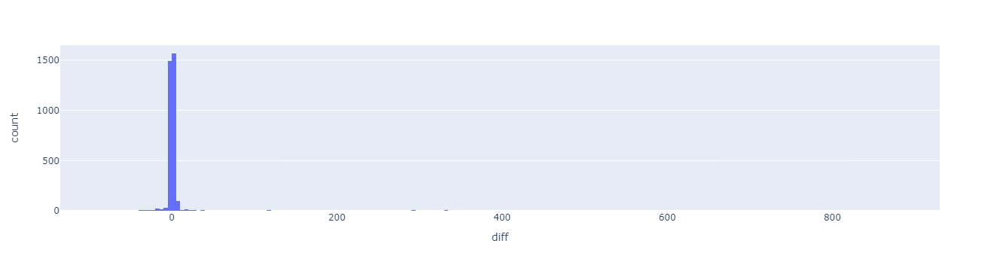

In [7]:
px.histogram(all_crossings, 'diff')

In [14]:
from pyspark.sql.functions import concat, col, lit, year, month
import plotly.express as px

track_df = spark.sql(f"""
    SELECT * 
    FROM `project_aiu`.`osn_tracks_clustered`
    LIMIT 1000000;
""")

track_pdf = track_df.toPandas()

track_pdf['event_time'] = pd.to_datetime(track_pdf['event_time'], unit='s')

def meters_to_flight_level(baro_altitude_meters):
    """
    Convert barometric altitude in meters to Flight Level.
    
    Parameters:
        baro_altitude_meters (float): Barometric altitude in meters.
        
    Returns:
        int: Flight Level in hundreds of feet.
    """
    if pd.isnull(baro_altitude_meters):
        return None
    # Convert altitude from meters to feet
    baro_altitude_feet = baro_altitude_meters * 3.28084
    
    # Calculate Flight Level
    flight_level = float(baro_altitude_feet / 100)
    
    return round(flight_level)

track_pdf['FL'] = track_pdf['baro_altitude'].apply(lambda l:meters_to_flight_level(l))

# FL of interest
FL = [40, 70, 100, 245]

FL_pdf = track_pdf[track_pdf['FL'].apply(lambda l:l in FL)] 

# Sort the DataFrame
df_sorted = FL_pdf.sort_values(['track_id', 'event_time', 'FL'])

# Drop duplicates based on 'track_id' and 'FL', keeping the first occurrence
df_first_FL = df_sorted.drop_duplicates(subset=['track_id', 'FL'], keep='first')
df_last_FL = df_sorted.drop_duplicates(subset=['track_id', 'FL'], keep='last')

df_first_FL['FL_first_last_seen'] = 'first'
df_last_FL['FL_first_last_seen'] = 'last'

df_first_last_FL = pd.concat([df_first_FL,df_last_FL])

track_pdf_fl = track_pdf.merge(df_first_last_FL[['track_id','event_time','FL_first_last_seen']], how='left',on=['track_id','event_time'])

track_pdf_fl['FL_first_last_seen'] = track_pdf_fl['FL_first_last_seen'].fillna('other')
#

TypeError: Invalid argument, not a string or column: 2.000000064 of type <class 'float'>. For column literals, use 'lit', 'array', 'struct' or 'create_map' function.

In [ ]:
track_pdf_fl_f = track_pdf_fl[track_pdf_fl['track_id']=='005e15fc80ff0f5235b8cfadfd0e6bbe1498688ad322dd3d5166b4086cf5943f_0_2022_12']

In [ ]:
px.scatter(track_pdf_fl_f, x='event_time',y='FL', color = 'FL_first_last_seen')

In [ ]:
# Show or store the result
#df_with_distances = df_with_distances.toPandas()

In [20]:
# Show or store the result
df = df.toPandas()

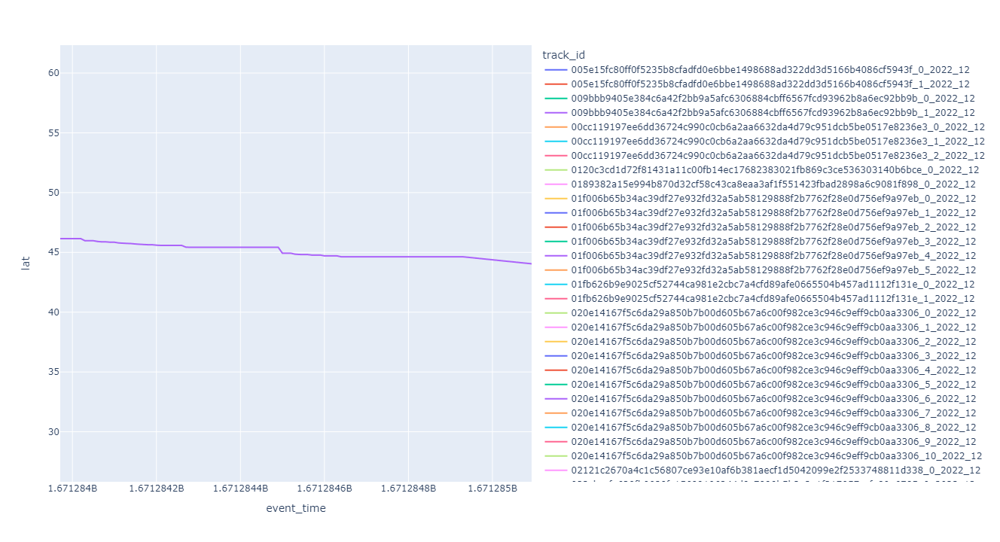

In [4]:
import plotly.express as px
px.line(df, x='event_time', y = 'lat', color='track_id')

In [21]:
df_t = df[df.track_id.str.contains('cd22d6')]

In [22]:
df_t = df_t.merge(df_t.groupby(['lat','lon']).count()['event_time'].reset_index().rename({'event_time':'count'},axis=1), on=['lat','lon'], how='left')

In [77]:
pd.Timestamp(1671281070, unit='s')-1670662810

Timestamp('2022-12-17 12:44:30')

In [78]:
pd.Timestamp(1670662810, unit='s')

Timestamp('2022-12-10 09:00:10')

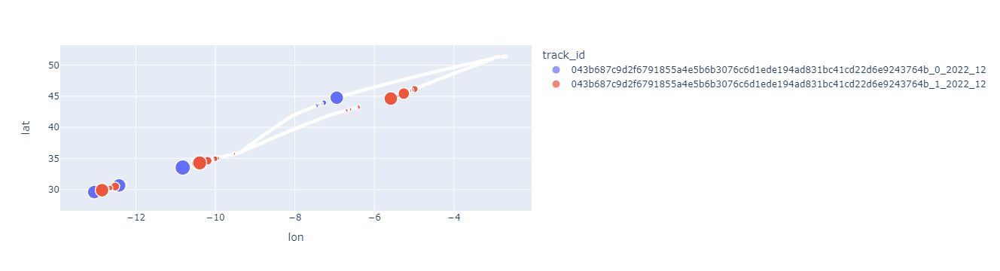

In [80]:
px.scatter(df_t, x='lon', y = 'lat', color='track_id', size = 'count')

In [26]:
df_t

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,serials,track_id,h3_id_res_11,count
0,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
1,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
2,1670662660,40773b,51.384383,-2.715836,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a509fff,3
3,1670662670,40773b,51.384407,-2.715149,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a572fff,3
4,1670662670,40773b,51.384407,-2.715149,NaN,NaN,NaN,TOM2HW,True,False,False,None,NaN,NaN,1.670663e+09,1.670663e+09,[-1408231737],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b195874a572fff,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5826,1671292190,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5827,1671292190,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5828,1671292200,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90
5829,1671292200,40773b,29.886025,-12.854165,241.046523,208.698292,-13.0048,TOM2HW,False,False,False,None,10789.92,11338.56,1.671292e+09,1.671292e+09,[],043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b346db1db66fff,90


In [24]:
test_df = pd.read_parquet('test_df.parquet')#spark.sql("""SELECT * FROM `project_aiu`.`osn_statevectors_clustered` WHERE icao24 = '40773b' and (event_time > 1670662660) and (event_time < 1671292200);""")
#test_df = test_df.toPandas()

In [32]:
test_df = test_df[test_df.callsign.fillna('').str.contains('TOM2HW')]

In [48]:
tmp = df_t[df_t.lat >= 44.76471][df_t.lat <= 44.76473]

/tmp/ipykernel_705/4030036247.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [68]:
tmp = tmp[[x for x in tmp.columns if x != 'serials']]

In [72]:
tmp

,event_time,icao24,lat,lon,velocity,heading,vert_rate,callsign,on_ground,alert,spi,squawk,baro_altitude,geo_altitude,last_pos_update,last_contact,track_id,h3_id_res_11,count
1158,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1159,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1160,1670666540,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1161,1670666550,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1162,1670666550,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1243,1670666820,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1244,1670666820,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1245,1670666830,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90
1246,1670666830,40773b,44.764725,-6.948317,245.842879,196.159492,0.0,TOM2HW,False,False,False,2030,11887.2,11818.62,1.670667e+09,1.670667e+09,043b687c9d2f6791855a4e5b6b3076c6d1ede194ad831b...,8b185a866872fff,90


In [ ]:
tmp[[x for x in tmp.columns if x != 'serials']].drop_duplicates

In [33]:
import plotly.express as px

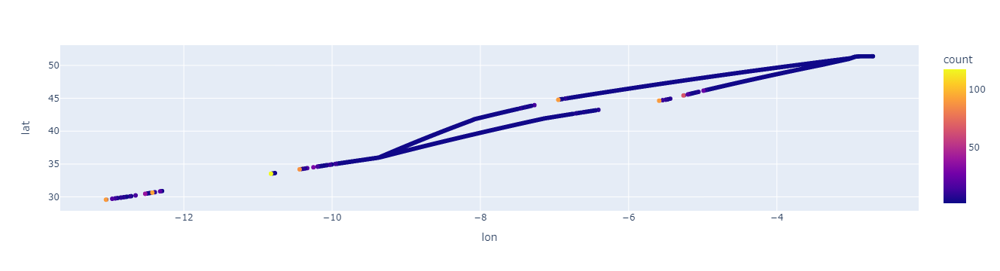

In [34]:
px.scatter(test_df, x='lon', y = 'lat', color='count')

In [ ]:
sv_df = spark.sql("""SELECT * FROM `project_aiu`.`osn_tracks_clustered` where callsign LIKE '%EXS94UJ%';""")
sv_df = sv_df.toPandas()

Hive Session ID = b3669249-b509-4c3d-ab28-fa72809a44ee


In [ ]:
sv_df

In [ ]:
sv_df['event_time'] = pd.to_datetime(sv_df['event_time'], unit = 's')

In [ ]:
f = np.logical_and(sv_df['event_time'] > pd.to_datetime('2022-07-22 21:00'), sv_df['event_time'] <= pd.to_datetime('2022-07-23 00:00'))

sv_df[f]

In [1]:
from traffic.data import opensky
flight = opensky.history(
    "2022-07-22 21:00",
    stop="2022-07-23 00:00",
    icao24="",
    # returns a Flight instead of a Traffic
    return_flight=True
)

Output()

/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

/usr/local/lib/python3.9/site-packages/traffic/data/adsb/opensky_impala.py:912: TqdmExperimentalWarning: rich is experimental/alpha
  for bt, at, bh, ah in progressbar(sequence):


/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

/usr/local/lib/python3.9/site-packages/ipywidgets/widgets/widget_output.py:111: DeprecationWarning: 
Kernel._parent_header is deprecated in ipykernel 6. Use .get_parent()
  if ip and hasattr(ip, 'kernel') and hasattr(ip.kernel, '_parent_header'):

In [3]:
flight.data

,alert,altitude,callsign,geoaltitude,groundspeed,hour,icao24,last_position,latitude,longitude,onground,spi,squawk,timestamp,track,vertical_rate
0,False,36000.0,NaN,NaN,NaN,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,None,2022-07-22 21:10:27+00:00,NaN,NaN
1,False,36000.0,NaN,NaN,NaN,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:28+00:00,NaN,NaN
2,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:29+00:00,20.404228,0.0
3,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:30+00:00,20.404228,0.0
4,False,36000.0,NaN,38325.0,442.0,2022-07-22 21:00:00+00:00,406a62,NaT,NaN,NaN,False,False,6243,2022-07-22 21:10:31+00:00,20.404228,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3594,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:55+00:00,88.698047,-128.0
3595,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:56+00:00,88.698047,-128.0
3596,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:57+00:00,88.698047,-128.0
3597,False,NaN,EXS94UJ,NaN,132.0,2022-07-22 23:00:00+00:00,406a62,2022-07-22 23:58:32.376000+00:00,52.827267,-1.328049,True,False,7470,2022-07-22 23:59:58+00:00,88.698047,-128.0


In [11]:
fdf.groupby(['latitude','longitude']).count()['hour'].reset_index().rename({'hour':'count'},axis=1)

,latitude,longitude,count
0,36.751316,-11.147617,61
1,36.867416,-11.093854,181
2,37.211288,-10.933442,1
3,37.214905,-10.931747,5
4,37.222843,-10.927993,43
...,...,...,...
4864,52.830692,-1.344962,1
4865,52.830738,-1.343706,3
4866,52.830780,-1.339493,31
4867,52.831158,-1.319332,21


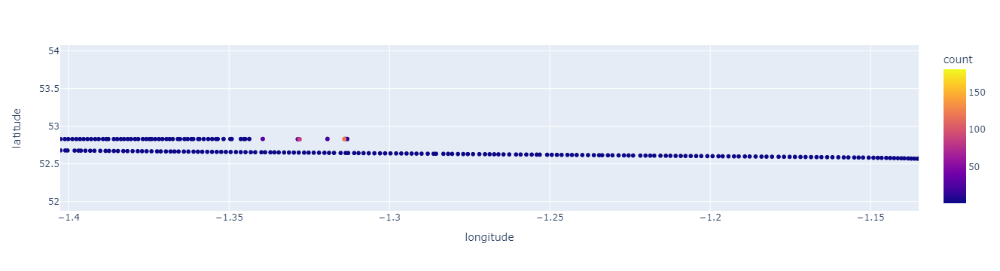

In [13]:
import plotly.express as px

fdf = flight.data
fdf = fdf.merge(fdf.groupby(['latitude','longitude']).count()['hour'].reset_index().rename({'hour':'count'},axis=1), on=['latitude','longitude'], how='left')

px.scatter(fdf, x='longitude', y = 'latitude', color = 'count')

In [2]:
df = spark.sql("""
    SELECT 
        icao24,
        flt_id,
        track_id,
        adep,
        adep_min_distance_km,
        adep_min_distance_time,
        ades,
        ades_min_distance_km,
        ades_min_distance_time
    FROM `project_aiu`.`osn_flight_table`
    WHERE ADEP IS NOT NULL AND ADES IS NOT NULL
    LIMIT 100000;
""")


pdf = df.toPandas()

pdf['adep_min_distance_time'] = pd.to_datetime(pdf['adep_min_distance_time'], unit='s')
pdf['ades_min_distance_time'] = pd.to_datetime(pdf['ades_min_distance_time'], unit='s')
pdf['time'] = pdf['ades_min_distance_time'] - pdf['adep_min_distance_time']
pdf['time_in_hours'] = pdf['time'].dt.total_seconds() / 3600.0

Hive Session ID = 0e077670-d7e7-4b94-947a-9752ee42a9f7


In [3]:
track_ids = pdf.track_id[:10].to_list()
track_ids_str = ', '.join([f"'{track_id}'" for track_id in track_ids])

In [4]:
# Complete the SQL query


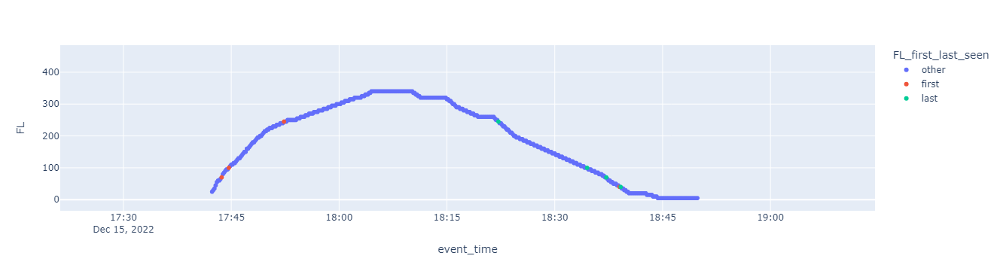

In [25]:
track_pdf

,event_time,icao24,lat,lon,on_ground,velocity,heading,vert_rate,callsign,squawk,baro_altitude,geo_altitude,serials,track_id,FLIGHT_LEVEL
0,2022-12-15 17:42:20,002e2a,48.364792,11.803401,False,92.201799,87.121631,13.65504,SPKCK,6666,746.76,716.28,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,24.0
1,2022-12-15 17:42:20,002e2a,48.364792,11.803401,False,92.201799,87.121631,13.65504,SPKCK,6666,746.76,716.28,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,24.0
2,2022-12-15 17:42:30,002e2a,48.365215,11.816519,False,100.574789,85.893503,16.25600,SPKCK,6666,891.54,853.44,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,29.0
3,2022-12-15 17:42:30,002e2a,48.365215,11.816519,False,100.574789,85.893503,16.25600,SPKCK,6666,891.54,853.44,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,29.0
4,2022-12-15 17:42:40,002e2a,48.366611,11.829746,False,98.195488,75.745349,26.98496,SPKCK,6666,1150.62,1127.76,"[-1408234507, -1408236373, 2098002593, -140823...",faff1082c1b8128de2634d557c8af44eb26e3f026a5d1a...,37.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14380,2022-11-05 16:59:30,003e53,34.780946,33.506012,False,97.557357,47.136911,0.00000,JDI20B,7110,586.74,655.32,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14381,2022-11-05 16:59:40,003e53,34.790582,33.518658,False,92.846810,47.470051,-0.32512,JDI20B,7110,594.36,662.94,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14382,2022-11-05 16:59:40,003e53,34.790582,33.518658,False,92.846810,47.470051,-0.32512,JDI20B,7110,594.36,662.94,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0
14383,2022-11-05 16:59:50,003e53,34.795982,33.525639,False,86.625404,46.925184,-2.92608,JDI20B,7110,579.12,647.70,[80706008],be3f5fc88d70327efc2568597c44db242d6c3ea2ece07d...,19.0


In [24]:
track_df 

DataFrame[event_time: string, icao24: string, lat: double, lon: double, on_ground: boolean, velocity: double, heading: double, vert_rate: double, callsign: string, squawk: string, baro_altitude: double, geo_altitude: double, serials: array<int>, track_id: string]